<a href="https://colab.research.google.com/github/AniruddhMukherjee/Image-OCR-comparison/blob/main/Image_OCR_comparison.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'textocr-text-extraction-from-images-dataset:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F2327240%2F3919937%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240305%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240305T173521Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D0ddba0abc1c04edd418e0045262c688992d093372b56c39d54a468d02205ba53c510778de40c7721ca3fdc8e9e5aa7657c21cbd1150893b73d063d8ce058e741e1f299f211dbc6bd2354c145a94e3b953909933394f124c5f7c92e98e9ed84dac8b54c56cf144982bf9c6bcd870f153ee6387cc4e98ed4faacb658658f7a0b6c2d79e4eefca254d7461ba7c5552a75d9921366157ccc24c02a20c2fb1149b417755340aedbc6eb5781d97512d4c8fb4371a8488012958264aab7e82e5270b95db7c4a305b9025d496807b9dea6badf8f58dcce198c6bd89d49f2546883e1e442fe554e025b2d935cc566fd8ec971ef94fb3ab20fdcab1ef433fe592b3607149e'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


[==================================================] 7224184156 bytes downloaded
Downloaded and uncompressed: textocr-text-extraction-from-images-dataset
Data source import complete.


In [2]:
import pandas as pd
import numpy as np

from glob import glob
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
from PIL import Image

from tqdm import tqdm, trange
from difflib import SequenceMatcher

plt.style.use('ggplot')

!pip install keras-ocr -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.3/42.3 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.5/9.5 MB 31.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 kB 42.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 5.4 MB/s eta 0:00:00


In [3]:
annot = pd.read_parquet('../input/textocr-text-extraction-from-images-dataset/annot.parquet')
imgs = pd.read_parquet('../input/textocr-text-extraction-from-images-dataset/img.parquet')
img_fns = glob('../input/textocr-text-extraction-from-images-dataset/train_val_images/train_images/*')

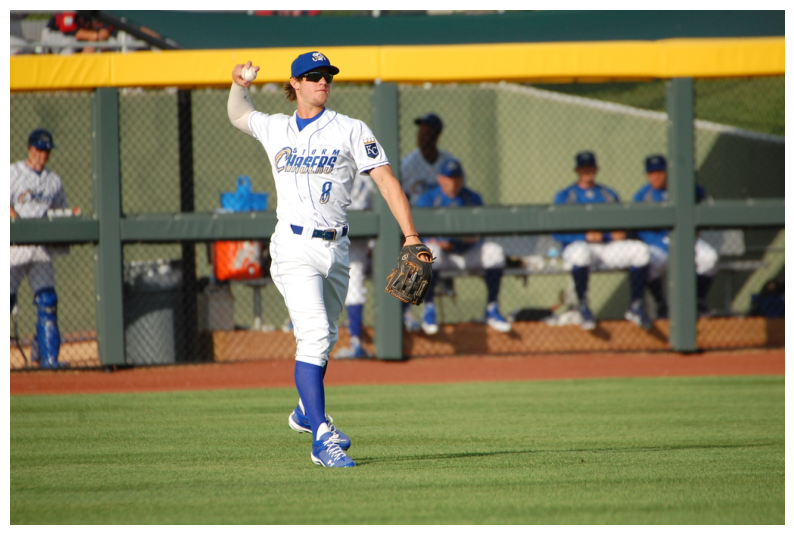

In [4]:
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(plt.imread(img_fns[0]))
ax.axis('off')
plt.show()

In [5]:
image_id = img_fns[0].split('/')[-1].split('.')[0]
annot.query('image_id == @image_id')

,id,image_id,bbox,utf8_string,points,area
149960,8090a2d8630baf4c_1,8090a2d8630baf4c,"[534.49, 310.11, 20.96, 10.48]",.,"[555.45, 320.59, 534.82, 320.59, 534.49, 310.4...",219.66
149961,8090a2d8630baf4c_2,8090a2d8630baf4c,"[519.47, 324.23, 4.91, 6.06]",.,"[519.47, 325.7, 523.23, 324.23, 524.38, 329.14...",29.75
149962,8090a2d8630baf4c_3,8090a2d8630baf4c,"[407.55, 226.64, 19.11, 32.76]",8,"[407.55, 226.64, 426.66, 226.64, 426.66, 258.9...",626.04
149963,8090a2d8630baf4c_4,8090a2d8630baf4c,"[468.11, 175.76, 19.6, 19.36]",KC,"[468.11, 180.23, 483.25, 175.76, 487.71, 191.3...",379.46
149964,8090a2d8630baf4c_5,8090a2d8630baf4c,"[8.96, 235.07, 47.9, 24.08]",.,"[8.96, 235.32, 56.62, 235.07, 56.86, 259.15, 8...",1153.43
149965,8090a2d8630baf4c_6,8090a2d8630baf4c,"[348.23, 180.47, 85.38, 39.46]",CHASERS,"[348.23, 180.47, 433.61, 180.72, 433.61, 219.6...",3369.09
149966,8090a2d8630baf4c_7,8090a2d8630baf4c,"[371.69, 181.83, 66.02, 12.9]",STORM,"[371.69, 181.83, 437.71, 181.83, 437.71, 194.7...",851.66


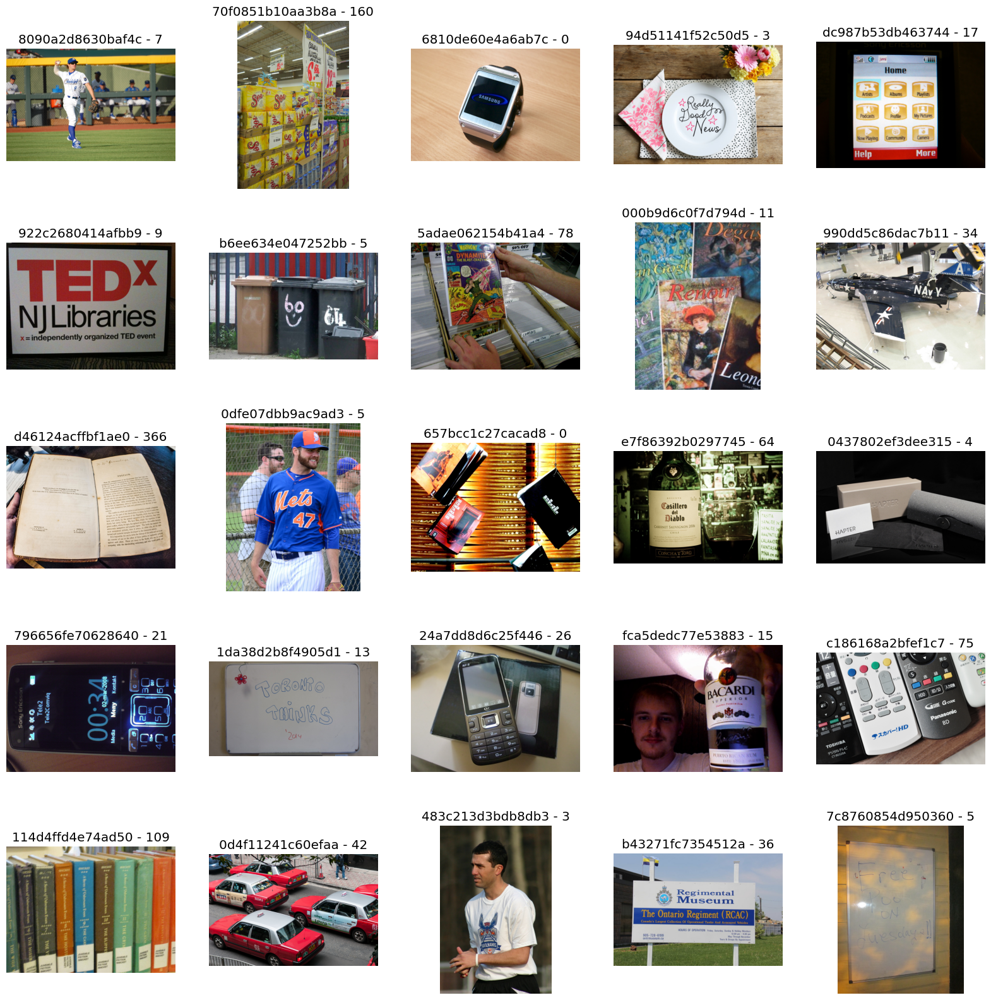

In [6]:
fig, axs = plt.subplots(5, 5, figsize=(20, 20))
axs = axs.flatten()
for i in range(25):
    axs[i].imshow(plt.imread(img_fns[i]))
    axs[i].axis('off')
    image_id = img_fns[i].split('/')[-1].rstrip('.jpg')
    n_annot = len(annot.query('image_id == @image_id'))
    axs[i].set_title(f'{image_id} - {n_annot}')
plt.show()

# Modified OCR

In [28]:
!pip install easyocr
import easyocr

reader = easyocr.Reader(['en'], gpu = True)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 20.2 MB/s eta 0:00:00


Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

In [31]:
results = reader.readtext(img_fns[11])
print(results)

[([[395, 525], [559, 525], [559, 653], [395, 653]], '47', 0.9998140531683466), ([[283.16299392693685, 401.09954412781923], [541.0774161585313, 377.4697138395784], [544.8370060730631, 526.9004558721807], [286.92258384146874, 549.5302861604216]], 'Ilel', 0.8526763319969177)]


In [30]:
pd.DataFrame(results, columns=['bbox','text','conf'])

,bbox,text,conf
0,"[[395, 525], [559, 525], [559, 653], [395, 653]]",47,0.999814
1,"[[283.16299392693685, 401.09954412781923], [54...",Ilel,0.852676


# Method 3: keras_ocr

In [32]:
import keras_ocr

pipeline = keras_ocr.pipeline.Pipeline()

Looking for /root/.keras-ocr/craft_mlt_25k.h5


Instructions for updating:
Use `tf.image.resize(...method=ResizeMethod.BILINEAR...)` instead.


Looking for /root/.keras-ocr/crnn_kurapan.h5


In [33]:
results = pipeline.recognize([img_fns[11]])

1/1 [==============================] - 3s 3s/step


In [34]:
pd.DataFrame(results[0], columns=['text', 'bbox'])

,text,bbox
0,lets,"[[291.8073, 417.0287], [525.73676, 397.05908],..."
1,oa,"[[687.7037, 517.2351], [739.3321, 476.28836], ..."
2,d,"[[754.20013, 540.4001], [787.8001, 523.60004],..."
3,47,"[[417.25504, 541.9066], [544.3723, 548.71643],..."


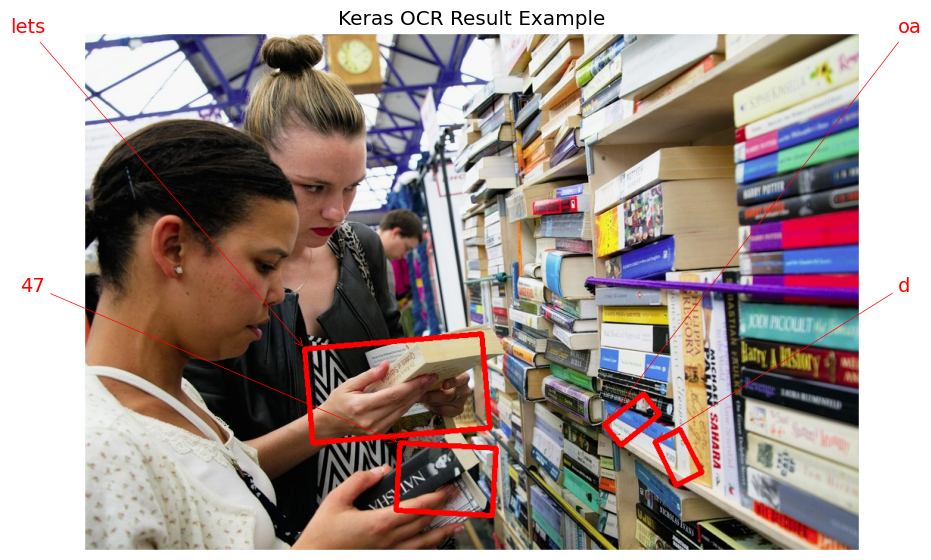

In [41]:
fig, ax = plt.subplots(figsize=(10, 10))
keras_ocr.tools.drawAnnotations(plt.imread(img_fns[180]), results[0], ax=ax)
ax.set_title('Keras OCR Result Example')
plt.show()

# compare easyocr vs keras_ocr

In [42]:
# easyocr
reader = easyocr.Reader(['en'], gpu = True)

dfs = []
for img in tqdm(img_fns[:25]):
    result = reader.readtext(img)
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['bbox','text','conf'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
easyocr_df = pd.concat(dfs)

100%|██████████| 25/25 [06:05<00:00, 14.62s/it]


In [43]:
# keras_ocr
pipeline = keras_ocr.pipeline.Pipeline()

dfs = []
for img in tqdm(img_fns[:25]):
    results = pipeline.recognize([img])
    result = results[0]
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['text', 'bbox'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
kerasocr_df = pd.concat(dfs)

Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5


  0%|          | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 3s 3s/step


  4%|▍         | 1/25 [00:46<18:39, 46.66s/it]WARNING:tensorflow:5 out of the last 5 calls to <function Model.make_predict_function.<locals>.predict_function at 0x7c51e0fe9a20> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


2/2 [==============================] - 12s 4s/step


  8%|▊         | 2/25 [02:22<28:55, 75.45s/it]

1/1 [==============================] - 0s 279ms/step


 12%|█▏        | 3/25 [03:44<28:51, 78.69s/it]

1/1 [==============================] - 1s 693ms/step


 16%|█▌        | 4/25 [04:29<22:53, 65.42s/it]

1/1 [==============================] - 4s 4s/step


 20%|██        | 5/25 [05:56<24:21, 73.08s/it]

1/1 [==============================] - 2s 2s/step


 24%|██▍       | 6/25 [06:46<20:40, 65.29s/it]

1/1 [==============================] - 0s 483ms/step


 28%|██▊       | 7/25 [07:27<17:08, 57.13s/it]

1/1 [==============================] - 8s 8s/step


 32%|███▏      | 8/25 [08:57<19:11, 67.72s/it]

1/1 [==============================] - 2s 2s/step


 36%|███▌      | 9/25 [10:22<19:27, 72.99s/it]

1/1 [==============================] - 2s 2s/step


 40%|████      | 10/25 [11:46<19:08, 76.55s/it]

11/11 [==============================] - 84s 8s/step


 44%|████▍     | 11/25 [15:33<28:34, 122.48s/it]

1/1 [==============================] - 1s 931ms/step


 48%|████▊     | 12/25 [16:56<23:57, 110.58s/it]

1/1 [==============================] - 4s 4s/step


 52%|█████▏    | 13/25 [18:23<20:40, 103.39s/it]

1/1 [==============================] - 8s 8s/step


 56%|█████▌    | 14/25 [19:54<18:15, 99.61s/it] 

1/1 [==============================] - 1s 917ms/step


 60%|██████    | 15/25 [20:36<13:44, 82.46s/it]

1/1 [==============================] - 6s 6s/step


 64%|██████▍   | 16/25 [22:09<12:49, 85.55s/it]

1/1 [==============================] - 1s 1s/step


 68%|██████▊   | 17/25 [22:47<09:28, 71.10s/it]

1/1 [==============================] - 6s 6s/step


 72%|███████▏  | 18/25 [23:41<07:41, 65.94s/it]

1/1 [==============================] - 3s 3s/step


 76%|███████▌  | 19/25 [24:30<06:06, 61.05s/it]

2/2 [==============================] - 14s 5s/step


 80%|████████  | 20/25 [26:13<06:08, 73.66s/it]

2/2 [==============================] - 10s 2s/step


 84%|████████▍ | 21/25 [27:46<05:17, 79.41s/it]

1/1 [==============================] - 9s 9s/step


 88%|████████▊ | 22/25 [29:17<04:08, 82.93s/it]

1/1 [==============================] - 1s 513ms/step


 92%|█████████▏| 23/25 [30:40<02:45, 82.89s/it]

2/2 [==============================] - 10s 2s/step


 96%|█████████▌| 24/25 [32:13<01:25, 85.87s/it]

1/1 [==============================] - 1s 1s/step


100%|██████████| 25/25 [33:36<00:00, 80.68s/it]


In [44]:
def plot_compare(img_fn, easyocr_df, kerasocr_df):
    img_id = img_fn.split('/')[-1].split('.')[0]
    fig, axs = plt.subplots(1, 2, figsize=(15, 10))

    easy_results = easyocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    easy_results = [(x[0], np.array(x[1])) for x in easy_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn),
                                    easy_results, ax=axs[0])
    axs[0].set_title('easyocr results', fontsize=24)

    keras_results = kerasocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    keras_results = [(x[0], np.array(x[1])) for x in keras_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn),
                                    keras_results, ax=axs[1])
    axs[1].set_title('keras_ocr results', fontsize=24)
    plt.show()

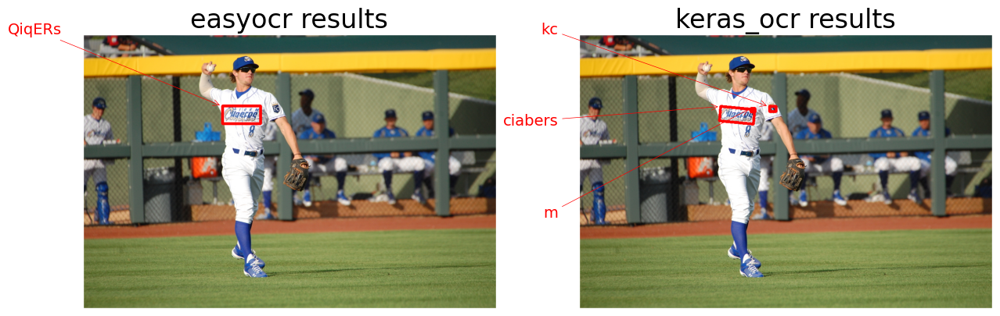

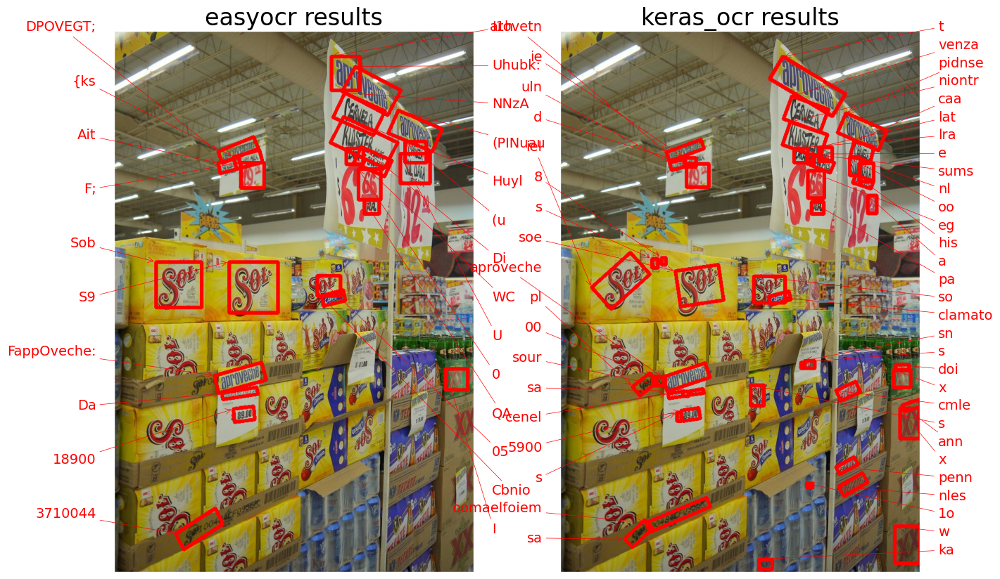

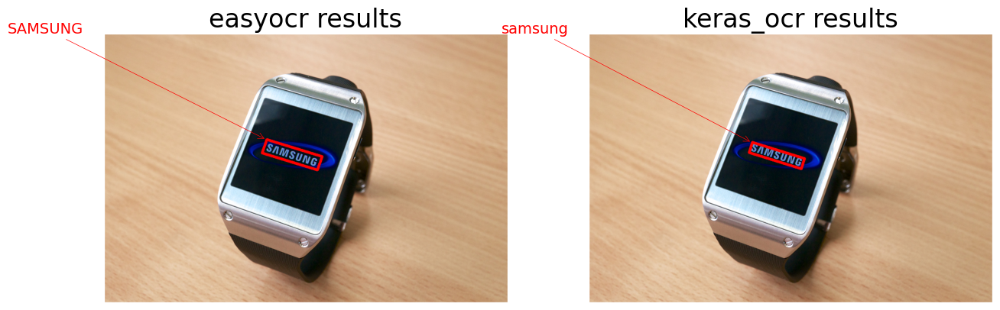

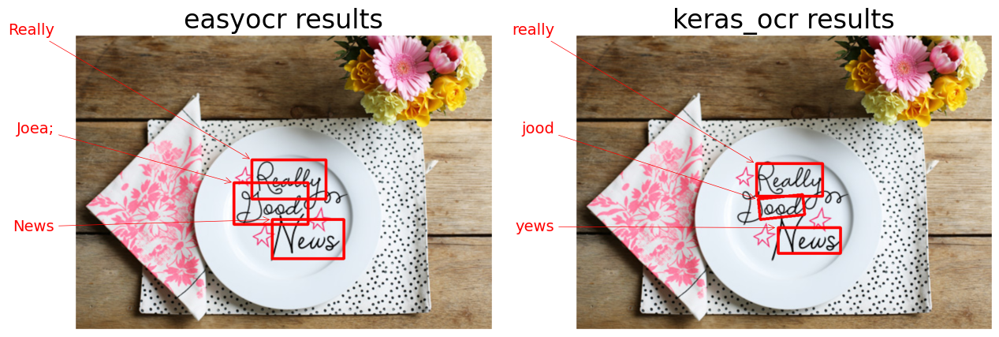

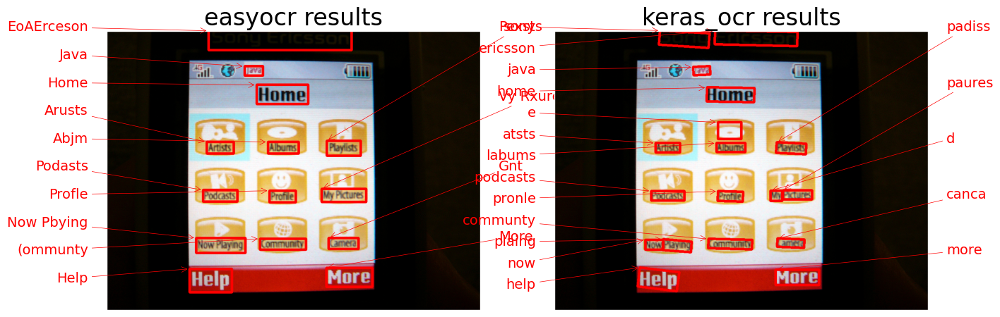

...

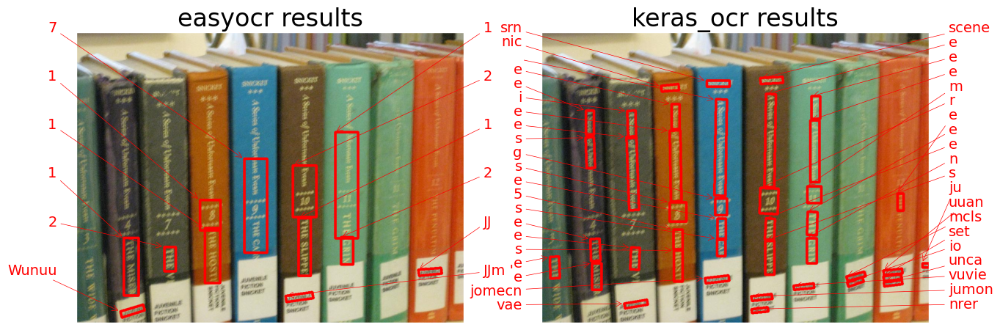

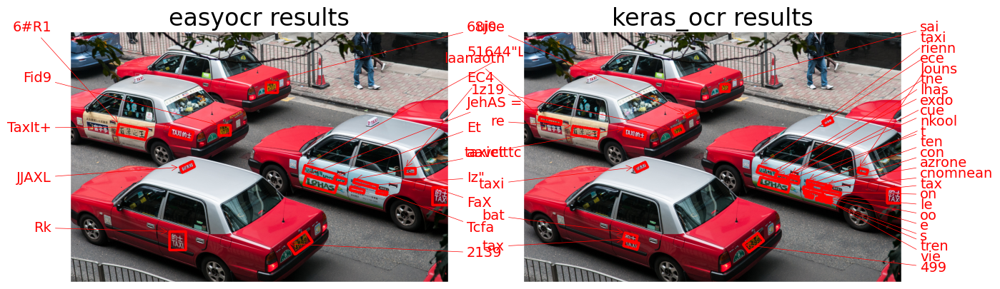

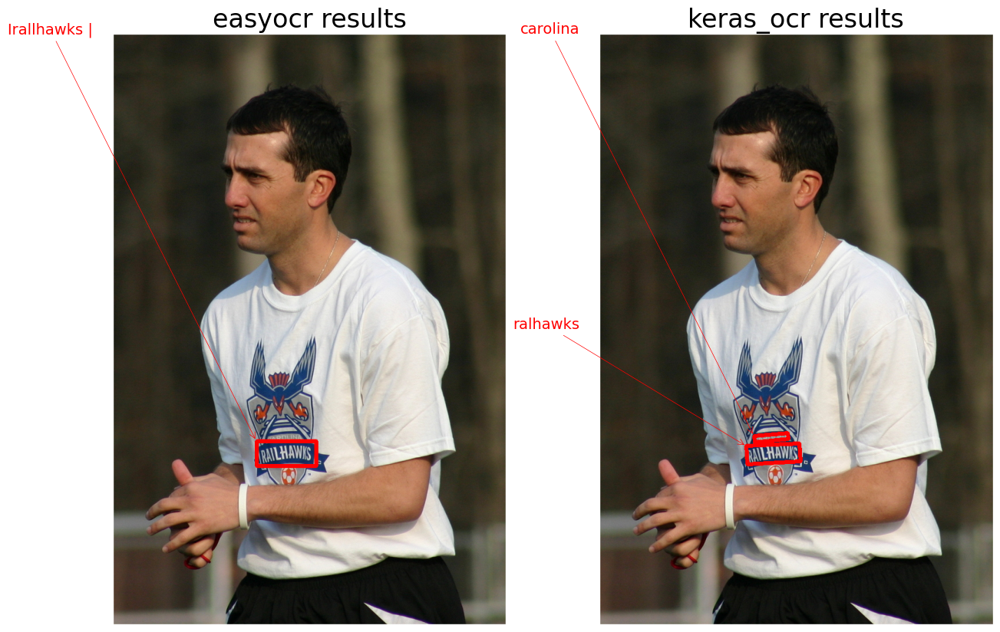

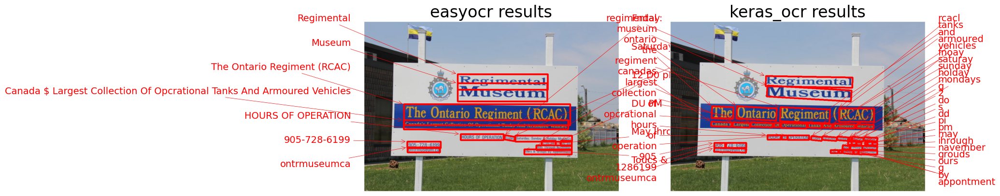

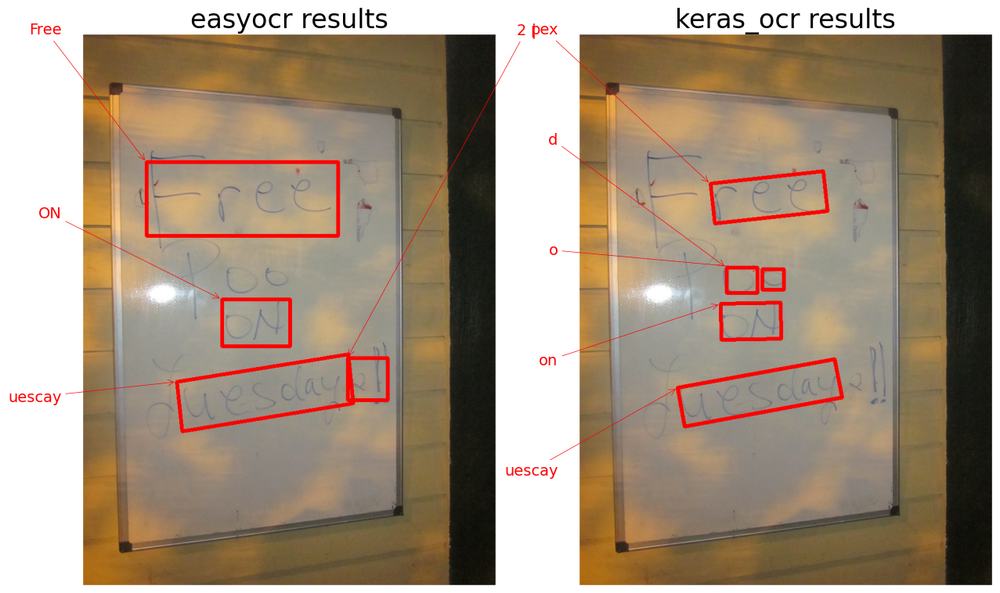

In [45]:
# Loop over results
for img_fn in img_fns[:25]:
    plot_compare(img_fn, easyocr_df, kerasocr_df)